In [1]:
import sys
import os
sys.path.append(os.path.abspath(os.path.join(
    '/Users/tylerviducic/dev/hockey_analytics/gamescore_model')))

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn import metrics, preprocessing
import seaborn as sns
from utils import helper_funcs
import glob

In [2]:
file_path = '/Users/tylerviducic/dev/hockey_analytics/gamescore_model/data/cleaned_data/whole_season/'
files = glob.glob(file_path + '*.csv')
df = pd.concat([pd.read_csv(f) for f in files], ignore_index=True)
df.drop(columns=['Unnamed: 0'], inplace=True)
df.describe()

,playerId,season,gameId,gameDate,icetime,shifts,gameScore,iceTimeRank,I_F_xOnGoal,I_F_xGoals,...,OnIce_A_unblockedShotAttempts,OnIce_A_scoreAdjustedUnblockedShotAttempts,OnIce_A_xGoalsFromxReboundsOfShots,OnIce_A_xGoalsFromActualReboundsOfShots,OnIce_A_reboundxGoals,OnIce_A_xGoals_with_earned_rebounds,OnIce_A_xGoals_with_earned_rebounds_scoreAdjusted,OnIce_A_xGoals_with_earned_rebounds_scoreFlurryAdjusted,home_score,away_score
count,6.357100e+05,635710.000000,6.357100e+05,6.357100e+05,635710.000000,635710.000000,635710.000000,635710.000000,635710.000000,635710.000000,...,635710.000000,635710.000000,635710.000000,635710.000000,635710.000000,635710.000000,635710.00000,635710.000000,635710.000000,635710.000000
mean,8.473328e+06,2015.023764,2.015044e+09,2.015662e+07,990.174611,21.391614,0.450611,5.481737,1.680391,0.155841,...,9.070839,9.092224,0.087494,0.093441,0.095902,0.511449,0.51314,0.505599,2.885135,2.619638
std,4.826895e+03,4.358557,4.358561e+06,4.398859e+04,292.598970,5.437033,0.734466,3.282639,1.393324,0.211990,...,4.218503,4.232453,0.045160,0.176746,0.178932,0.289507,0.29158,0.285368,1.678371,1.583953
min,8.445550e+06,2008.000000,2.008020e+09,2.008100e+07,1.000000,1.000000,-2.500000,1.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
25%,8.470612e+06,2011.000000,2.011021e+09,2.012012e+07,798.000000,18.000000,-0.060000,3.000000,0.692000,0.018000,...,6.000000,6.042000,0.055000,0.000000,0.000000,0.298000,0.29800,0.295000,2.000000,1.000000
50%,8.474162e+06,2015.000000,2.015021e+09,2.016013e+07,998.000000,22.000000,0.300000,5.000000,1.434000,0.077000,...,9.000000,8.698000,0.082000,0.000000,0.000000,0.472000,0.47300,0.467000,3.000000,2.000000
75%,8.476854e+06,2019.000000,2.019020e+09,2.019102e+07,1189.000000,25.000000,0.850000,8.000000,2.390000,0.208000,...,12.000000,11.684000,0.114000,0.141000,0.150000,0.680000,0.68200,0.672000,4.000000,4.000000
max,8.484287e+06,2022.000000,2.022021e+09,2.023041e+07,2334.000000,46.000000,7.110000,13.000000,14.722000,3.598000,...,42.000000,41.879000,0.446000,2.410000,2.410000,2.646000,2.74600,2.642000,10.000000,10.000000


In [3]:
def get_season_goal_diff(team, season):
    team_season_goal_df = pd.read_csv(
        '/Users/tylerviducic/dev/hockey_analytics/gamescore_model/data/kaggle_data/team_season_avg_goal_diff.csv')
    if team == 'ARI' and season < 2014:
        team = 'PHX'
    team_id = helper_funcs.mp_team_id_dict[team]
    return team_season_goal_df[(team_season_goal_df['team_id'] == team_id) & (team_season_goal_df['season'] == season)]['avg_goal_diff'].values[0]

In [4]:
df['avg_goal_diff'] = df.apply(lambda row: get_season_goal_diff(row['playerTeam'], row['season']), axis=1)  

team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, season: 2017
team: CAR, seaso

In [5]:
df.dropna(inplace=True)
print(df.head().to_string())

   playerId  season          name      gameId playerTeam opposingTeam home_or_away  gameDate position  icetime  shifts  gameScore  iceTimeRank  I_F_xOnGoal  I_F_xGoals  I_F_xRebounds  I_F_xFreeze  I_F_xPlayStopped  I_F_xPlayContinuedInZone  I_F_xPlayContinuedOutsideZone  I_F_flurryAdjustedxGoals  I_F_scoreVenueAdjustedxGoals  I_F_flurryScoreVenueAdjustedxGoals  I_F_primaryAssists  I_F_secondaryAssists  I_F_shotsOnGoal  I_F_missedShots  I_F_blockedShotAttempts  I_F_shotAttempts  I_F_points  I_F_goals  I_F_rebounds  I_F_reboundGoals  I_F_freeze  I_F_playStopped  I_F_playContinuedInZone  I_F_playContinuedOutsideZone  I_F_savedShotsOnGoal  I_F_savedUnblockedShotAttempts  penalties  I_F_penalityMinutes  I_F_faceOffsWon  I_F_hits  I_F_takeaways  I_F_giveaways  I_F_lowDangerShots  I_F_mediumDangerShots  I_F_highDangerShots  I_F_lowDangerxGoals  I_F_mediumDangerxGoals  I_F_highDangerxGoals  I_F_lowDangerGoals  I_F_mediumDangerGoals  I_F_highDangerGoals  I_F_scoreAdjustedShotsAttempts  I_F_unbl

In [6]:
rate_stats = ['OnIce_F_xGoals', 'OnIce_F_goals',
              'OnIce_A_xGoals', 'OnIce_A_goals']

for stat in rate_stats:
    df[stat] = np.where(True, df[stat] / df['icetime'] * 3600, 0)

In [7]:
from sklearn import model_selection

features = ['I_F_primaryAssists', 'I_F_secondaryAssists', 'I_F_goals', 'I_F_hits', 'I_F_takeaways', 
            'I_F_dZoneGiveaways', 'shotsBlockedByPlayer','faceoffsWon', 'faceoffsLost', 'penalties', 
            'penaltiesDrawn', 'OnIce_F_xGoals', 'OnIce_F_goals', 'OnIce_A_xGoals', 'OnIce_A_goals']
target = ['avg_goal_diff']

x_train, x_test, y_train, y_test = model_selection.train_test_split(df[features], df[target], test_size=0.2)

In [8]:
x_min_max_scaler = preprocessing.MinMaxScaler()
scaled_x_train = x_min_max_scaler.fit_transform(x_train)
scaled_x_test = x_min_max_scaler.fit_transform(x_test)

y_min_max_scaler = preprocessing.MinMaxScaler()
scaled_y_train = y_min_max_scaler.fit_transform(y_train)
scaled_y_test = y_min_max_scaler.fit_transform(y_test)




In [9]:
from sklearn.linear_model import LinearRegression

model = LinearRegression()

In [10]:
model.fit(scaled_x_train, scaled_y_train)

LinearRegression()

In [11]:
print(f'coeficcients: ')
for feature, coef in zip(features, model.coef_[0]):
    print(f'{feature}: {coef}')

coeficcients: 
I_F_primaryAssists: 0.03766894942843831
I_F_secondaryAssists: 0.036837341439945936
I_F_goals: 0.03384014652167122
I_F_hits: 0.0023562296888519447
I_F_takeaways: -0.0006774431257187947
I_F_dZoneGiveaways: -0.02934203483273069
shotsBlockedByPlayer: -0.031222869339656893
faceoffsWon: 0.03996698563647107
faceoffsLost: -0.040149481319378115
penalties: 0.004180739886068143
penaltiesDrawn: 0.004853062811297077
OnIce_F_xGoals: 0.489207233793616
OnIce_F_goals: 0.15534155975812358
OnIce_A_xGoals: -0.34671021826029147
OnIce_A_goals: -0.437183155172369


In [12]:
pred_y = model.predict(scaled_x_test)

In [13]:
from sklearn.metrics import mean_squared_error, r2_score

print(f'MSE: {mean_squared_error(scaled_y_test, pred_y)}')
print(f'R2: {r2_score(scaled_y_test, pred_y)}')

MSE: 0.027322907666967905
R2: -0.01871568007635993


In [14]:
from sklearn.model_selection import cross_validate
from sklearn.model_selection import RepeatedKFold

cv_model = cross_validate(
    model,
    scaled_x_train,
    scaled_y_train,
    cv=RepeatedKFold(n_splits=5, n_repeats=5),
    return_estimator=True
)

coefs = pd.DataFrame(
    [model_v.coef_[0] for model_v in cv_model['estimator']], columns=features
)

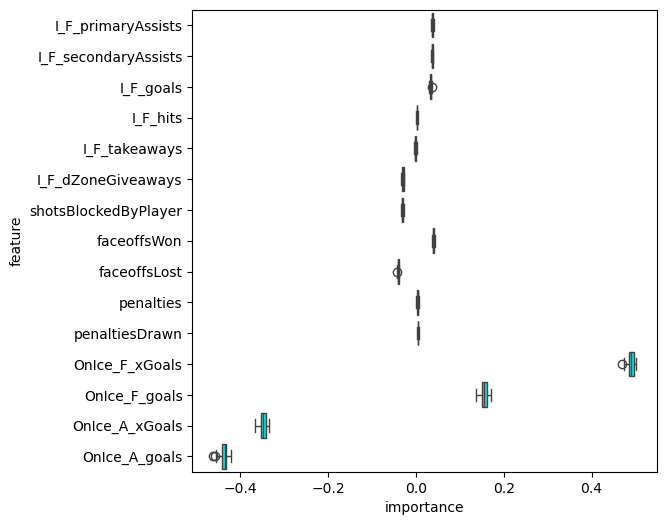

In [15]:
fig, ax = plt.subplots(figsize=(6, 6))
sns.boxplot(data=coefs, orient="h", ax=ax, color='cyan')
ax.set_xlabel('importance')
ax.set_ylabel('feature')
plt.show()